# Investigate the velocity fields for the isomip+ simulations within the ice shelf cavity
Author: McKenzie Larson

In [1]:
# %cd /pscratch/sd/m/mlarson/isomip_plus_2km_z-star_Ocean0/
# %source load_compass_env.sh
## import modules
import functions
import xarray as xr
import matplotlib.pyplot as plt
from matplotlib import pyplot as plt
import pandas as pd
import matplotlib.colors
import numpy as np

matplotlib.rcParams.update({'font.size': 16})

In [3]:
## load in the data
ds_land_ice_fluxes = xr.open_dataset('/pscratch/sd/m/mlarson/isomip_plus_2km_z-star_Ocean0/ocean/isomip_plus/planar/2km/z-star/Ocean0/simulation/land_ice_fluxes.nc')
ds_output = xr.open_dataset('/pscratch/sd/m/mlarson/isomip_plus_2km_z-star_Ocean0/ocean/isomip_plus/planar/2km/z-star/Ocean0/simulation/output.nc')
ds_timeMonthly = xr.open_mfdataset('/pscratch/sd/m/mlarson/isomip_plus_2km_z-star_Ocean0/ocean/isomip_plus/planar/2km/z-star/Ocean0/simulation/timeSeriesStatsMonthly.*.nc')

## load in the mesh and mask data for the 2-km grid
mesh = xr.open_dataset('/pscratch/sd/m/mlarson/dsMesh_2km.nc')
mask = xr.open_dataset('/pscratch/sd/m/mlarson/cavityMask_2km.nc')

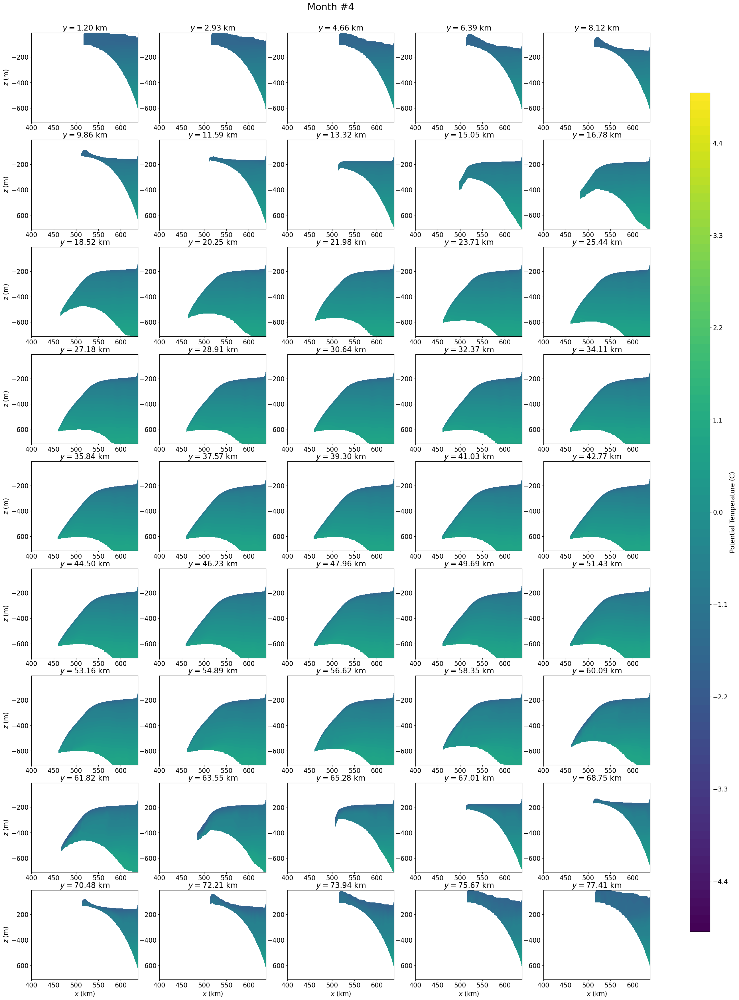

In [4]:
# %cd /global/homes/m/mlarson/mpas-ocean-vert-coord-testing
# import functions
functions.plot_x_z_cross_section(midx=4,ds_output=ds_output,ds_output_dot_var=ds_output.temperature,levs=np.arange(-5,5.1,0.1),cbar_str='Potential Temperature (C)',xmax=639,cmap="viridis")

In [16]:
pwd

'/global/u2/m/mlarson/mpas-ocean-vert-coord-testing'

In [1]:
## variables of use:

# ds_output.zMid             --> the depth of edge values is actually the same as the cell-centered values, zMid , which is located in the middle of each layer. 
#                                It’s calculated using bottomDepth and then adding up the layerThickness values in halves.


In [70]:
reshaped_xCell = [ds_output.xCell.values for i in range(len(ds_output.nVertLevels))]
reshaped_xCell = np.transpose(reshaped_xCell)
np.shape(reshaped_xCell)

(7319, 36)

In [68]:
np.shape(ds_output.zMid.isel(Time=0))

(7319, 36)

In [15]:
test = xr.open_dataset('/pscratch/sd/m/mlarson/isomip_plus_2km_sigma_Ocean0/ocean/isomip_plus/planar/2km/sigma/Ocean0/ssh_adjustment/output_ssh.nc')

In [16]:
test

<xarray.Dataset> Size: 644kB
Dimensions:  (Time: 1, nCells: 7319, nVertLevels: 10)
Dimensions without coordinates: Time, nCells, nVertLevels
Data variables:
    ssh      (Time, nCells) float64 59kB ...
    density  (Time, nCells, nVertLevels) float64 586kB ...
Attributes: (12/1312)
    model_name:                                                      mpas
    core_name:                                                       ocean
    source:                                                          MPAS
    Conventions:                                                     MPAS
    git_version:                                                     v3.0.0-1...
    on_a_sphere:                                                     NO
    ...                                                              ...
    config_rx1_slope_weight:                                         0.1
    config_rx1_zstar_weight:                                         1.0
    config_rx1_horiz_smooth_open_ocean_cells:                        20
    config_rx1_min_levels:                                           3
    config_rx1_min_layer_thickness:                                  1.0
    file_id:                                                         drf4y3nmhi

In [79]:
## see if the middle of the hexagon cell is in the cavity
nCell_idx_inCavity = []
for i in range(len(mesh.nCells)):
     if (mask.maxLevelCell.isel(nCells=i).values == True): ## see if the middle of the hexagon cell is in the cavity
        nCell_idx_inCavity.append(i)
        
# get the mesh info for the cells in the cavity
nCell_inCavity = mesh.isel(nCells = nCell_idx_inCavity)

furthest_x = mesh.xCell.isel(nCells = nCell_idx_inCavity[np.argmax(nCell_inCavity.xCell.values)]).values
print('Largest x-value:', furthest_x)

Largest x-value: 639000.0


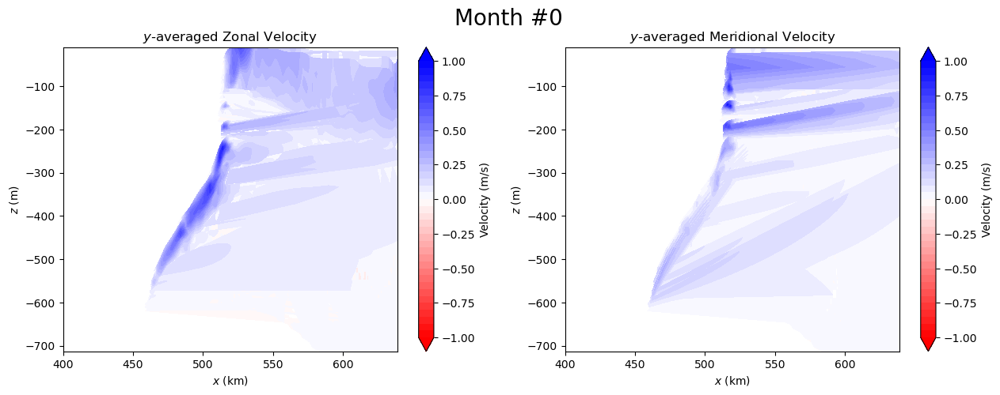

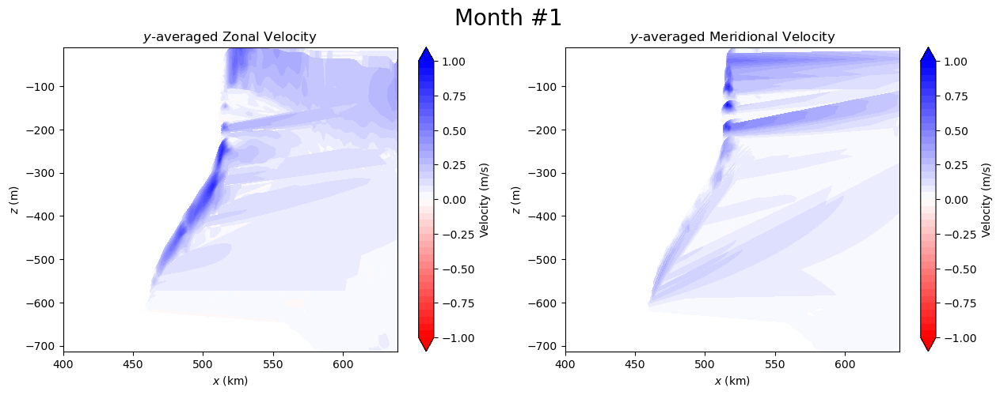

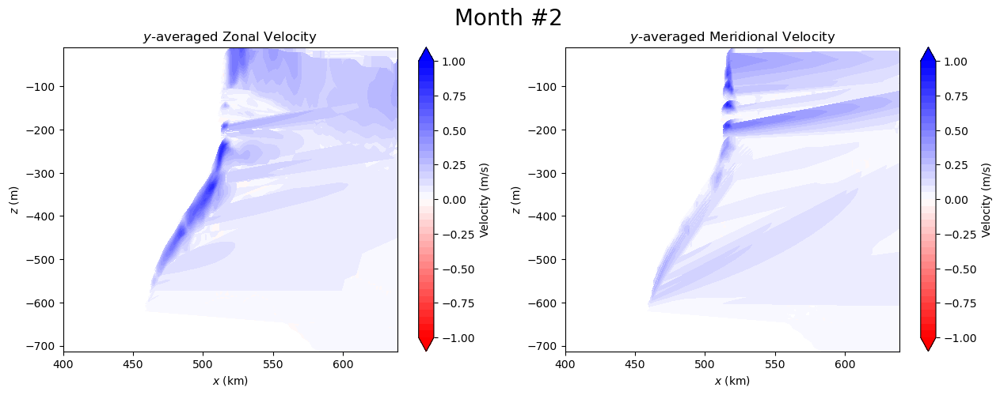

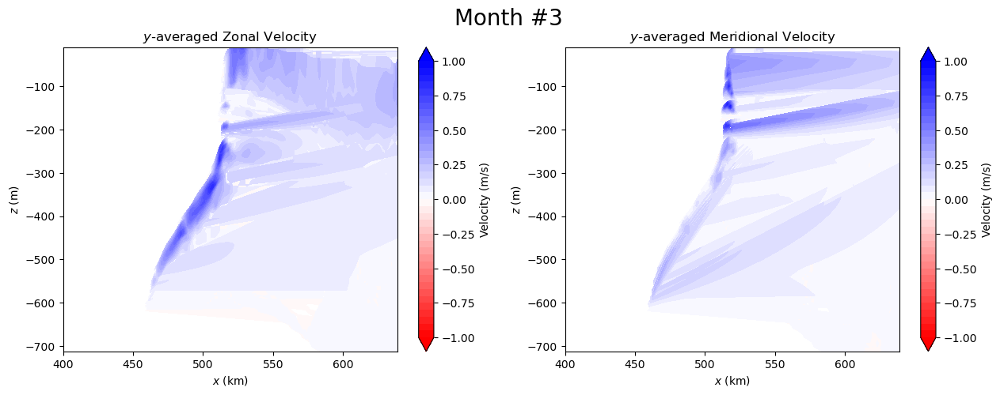

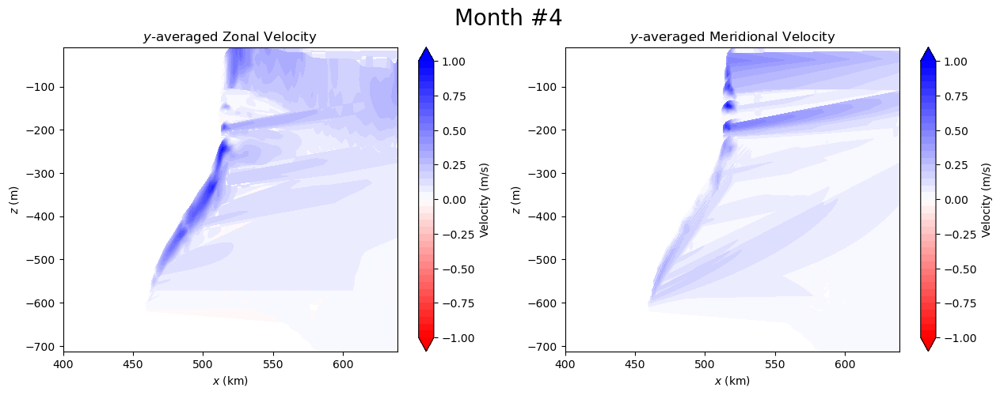

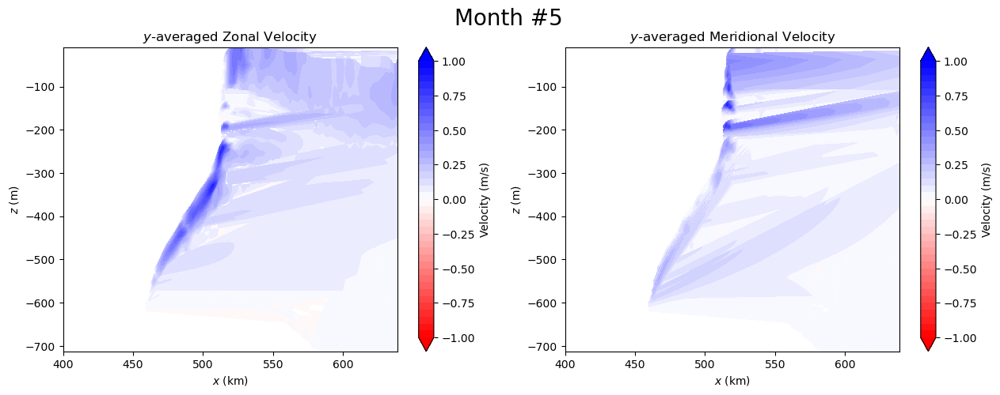

In [99]:
for midx in range(len(ds_output.Time)):
    fig, ax = plt.subplots(1,2, figsize = (15,5))

    ## create my own colormap
    cvals  = [-2., 0, 2]
    colors = ["red","white","blue"]

    norm=plt.Normalize(min(cvals),max(cvals))
    tuples = list(zip(map(norm,cvals), colors))
    cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", tuples)

    ## plot velocity contours
    levs = np.arange(-1,1.05,0.05)
    im = ax[0].contourf(reshaped_xCell/1000,ds_output.zMid.isel(Time=midx),ds_output.velocityX.isel(Time=midx), levels=levs, cmap=cmap,extend='both')
    # ax[0].contour(ds.x[0:furthest_x_idx+1]/1000,ds.z,ds.osf.isel(Time=0, nx=slice(0,furthest_x_idx+1)), cmap='Greys',levels=np.arange(-0.01,0.02,0.01))
    cb = fig.colorbar(im, orientation='vertical', label = 'Velocity (m/s)')
    ax[0].set_title('$y$-averaged Zonal Velocity')
    ax[0].set_xlabel('$x$ (km)')
    ax[0].set_ylabel('$z$ (m)')
    ax[0].set_xlim(400, 639000.0/1000)

    levs = np.arange(-1,1.05,0.05)
    im = ax[1].contourf(reshaped_xCell/1000,ds_output.zMid.isel(Time=midx),ds_output.velocityY.isel(Time=midx), levels=levs, cmap=cmap,extend='both')
    # ax[0].contour(ds.x[0:furthest_x_idx+1]/1000,ds.z,ds.osf.isel(Time=0, nx=slice(0,furthest_x_idx+1)), cmap='Greys',levels=np.arange(-0.01,0.02,0.01))
    cb = fig.colorbar(im, orientation='vertical', label = 'Velocity (m/s)')
    ax[1].set_title('$y$-averaged Meridional Velocity')
    ax[1].set_xlabel('$x$ (km)')
    ax[1].set_ylabel('$z$ (m)')
    ax[1].set_xlim(400, 639000.0/1000)

    fig.suptitle('Month #'+str(midx), size=20)
    plt.show()
    
    if midx == 5: break

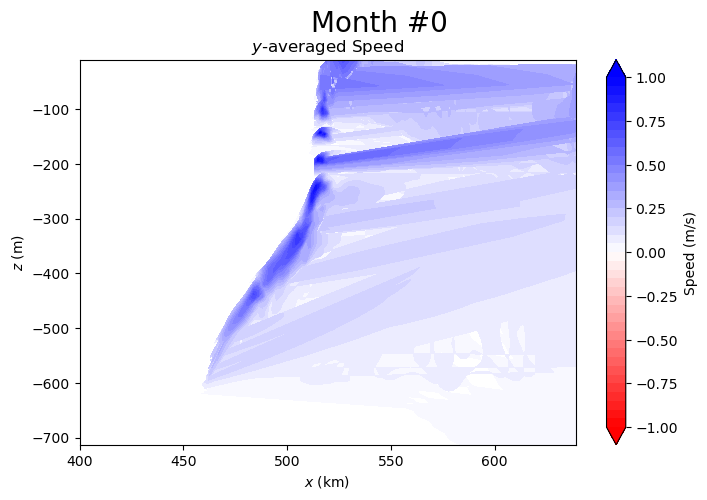

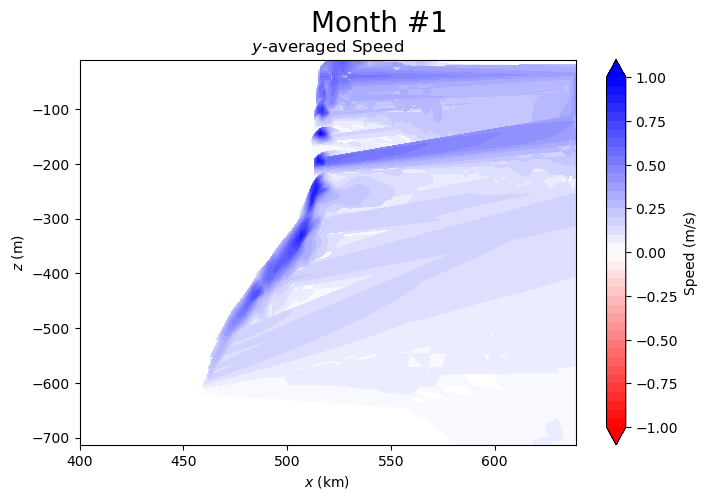

In [113]:
## speed
for midx in range(len(ds_output.Time)):
    fig, ax = plt.subplots(1, figsize = (8,5))

    ## create my own colormap
    cvals  = [-2., 0, 2]
    colors = ["red","white","blue"]

    norm=plt.Normalize(min(cvals),max(cvals))
    tuples = list(zip(map(norm,cvals), colors))
    cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", tuples)

    ## plot speed contours
    levs = np.arange(-1,1.05,0.05)
    speed = (ds_output.velocityX.isel(Time=midx)**2 + ds_output.velocityY.isel(Time=midx)**2)**0.5
    im = ax.contourf(reshaped_xCell/1000,ds_output.zMid.isel(Time=midx),speed, levels=levs, cmap=cmap,extend='both')
    cb = fig.colorbar(im, orientation='vertical', label = 'Speed (m/s)')
    ax.set_title('$y$-averaged Speed')
    ax.set_xlabel('$x$ (km)')
    ax.set_ylabel('$z$ (m)')
    ax.set_xlim(400, 639000.0/1000)
    
    fig.suptitle('Month #'+str(midx), size=20, ha='center')
    plt.show()
    
    if midx == 1: break

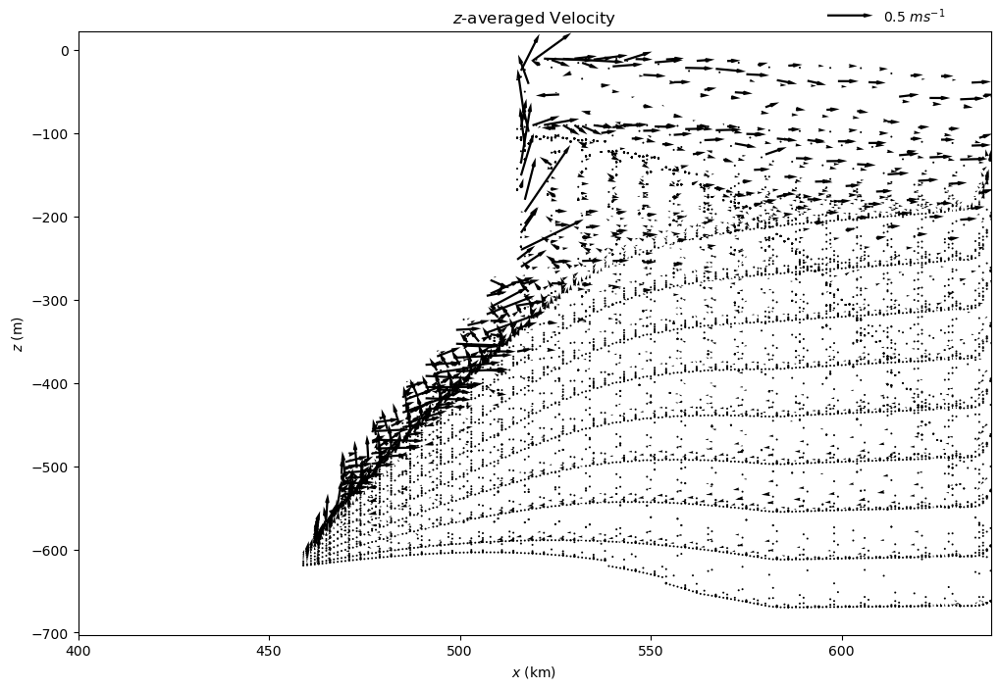

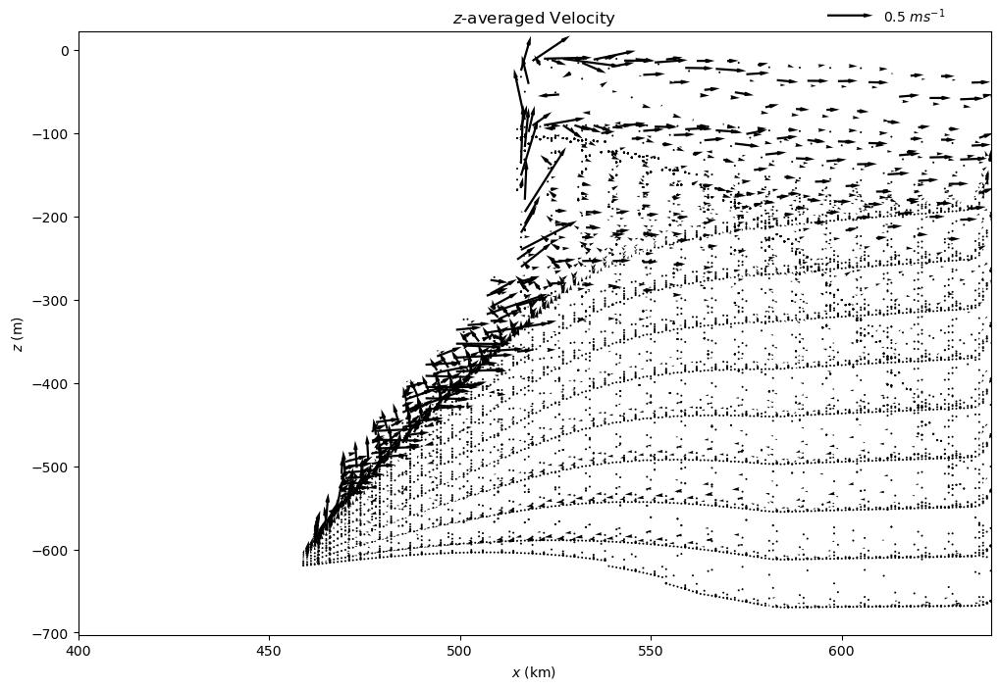

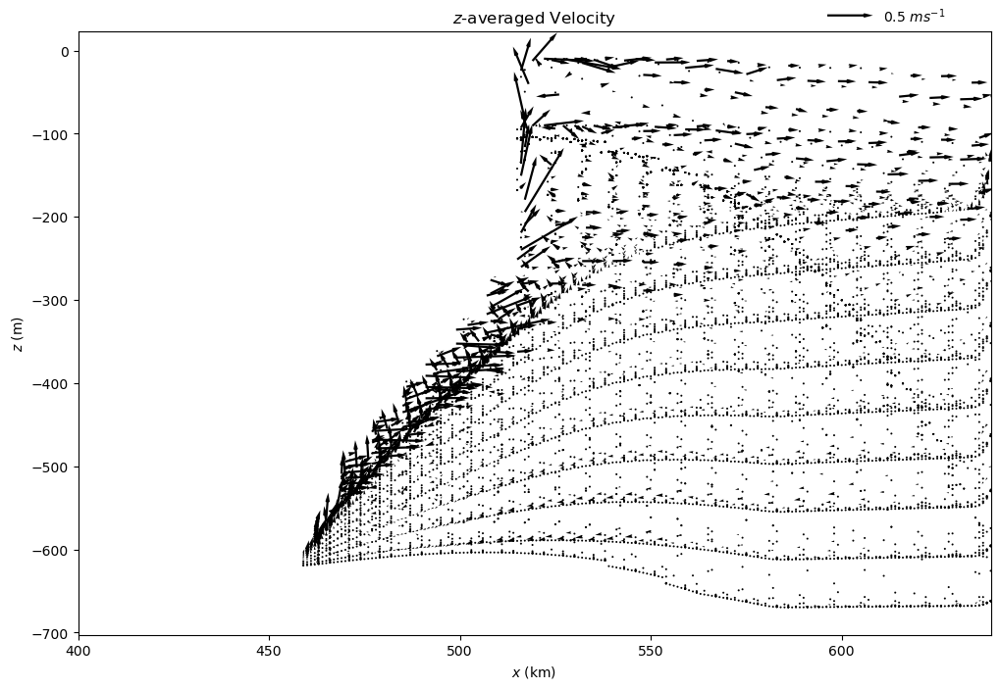

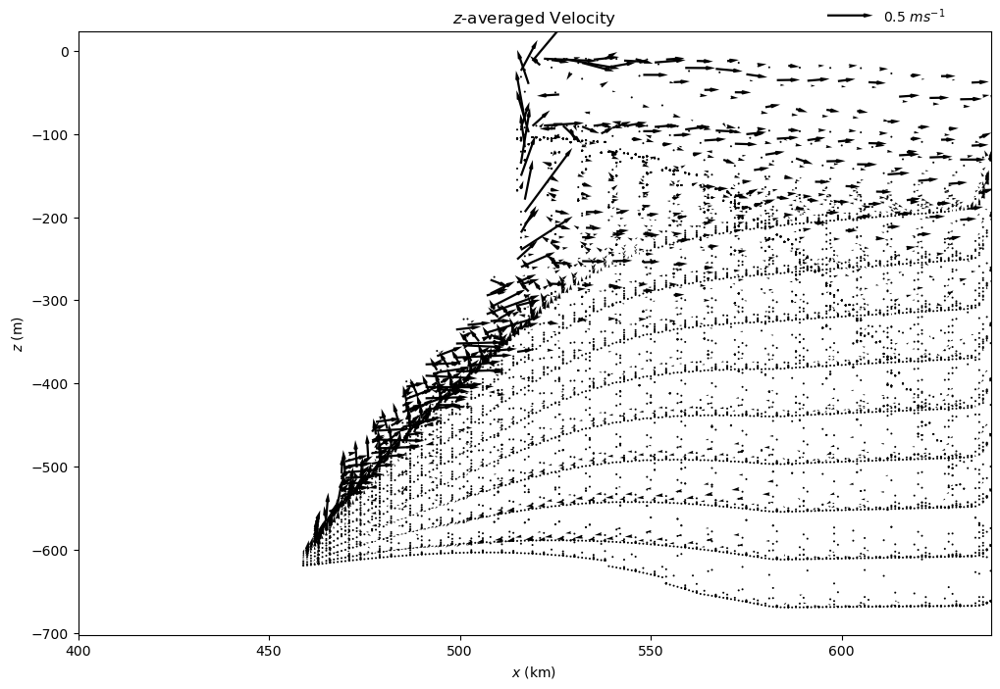

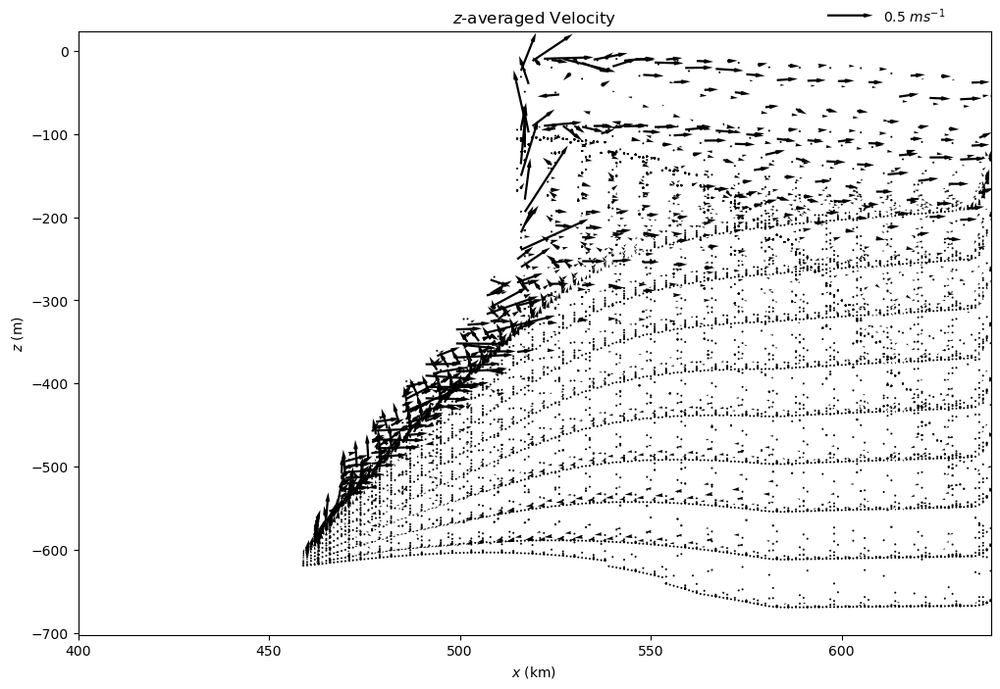

...

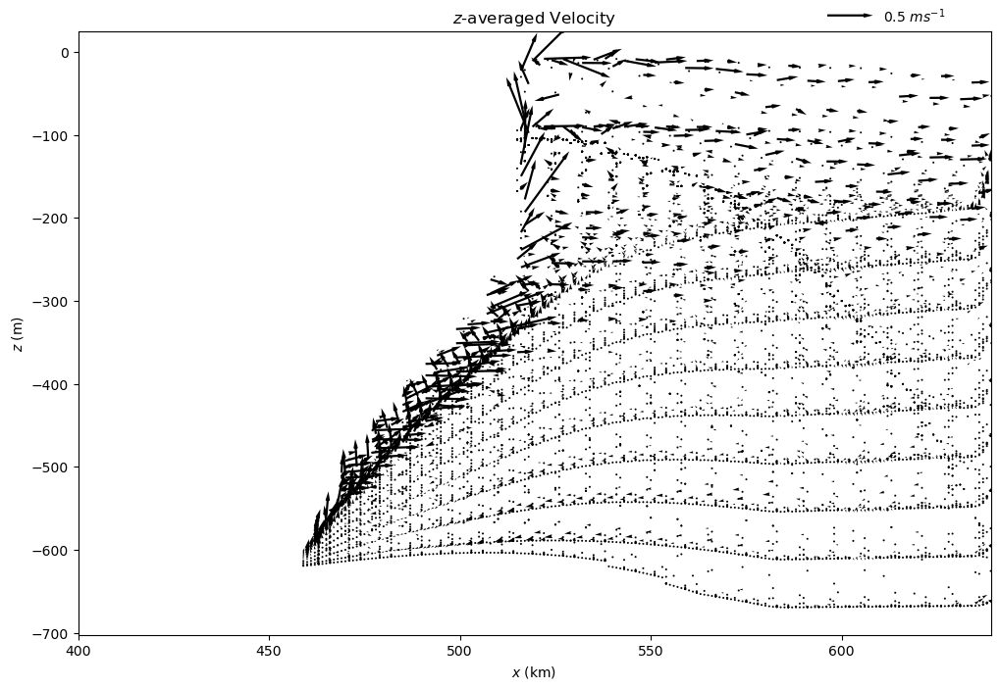

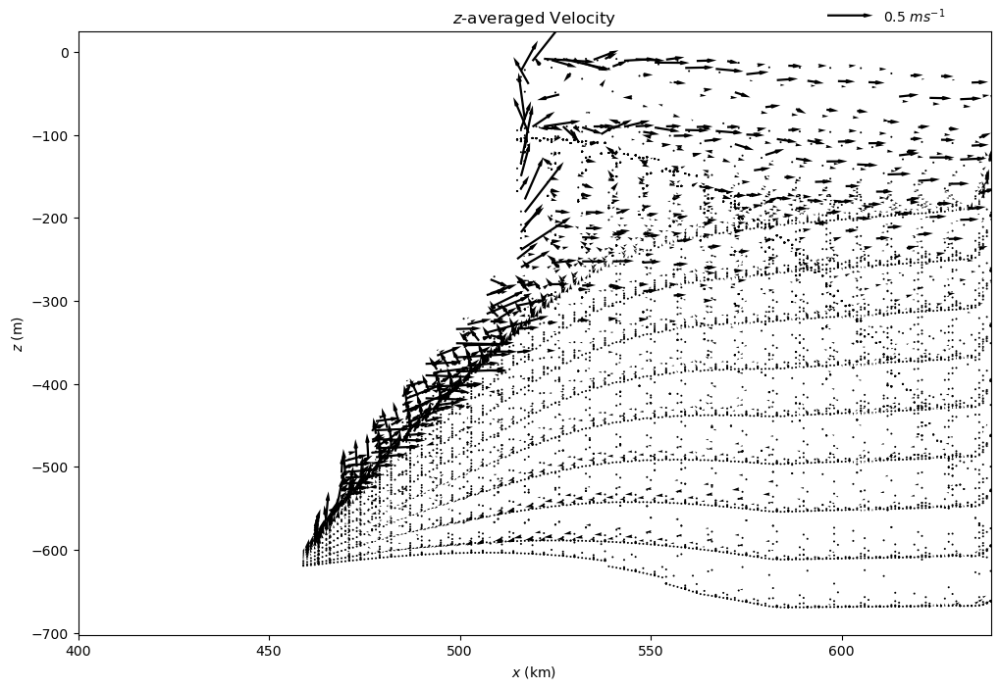

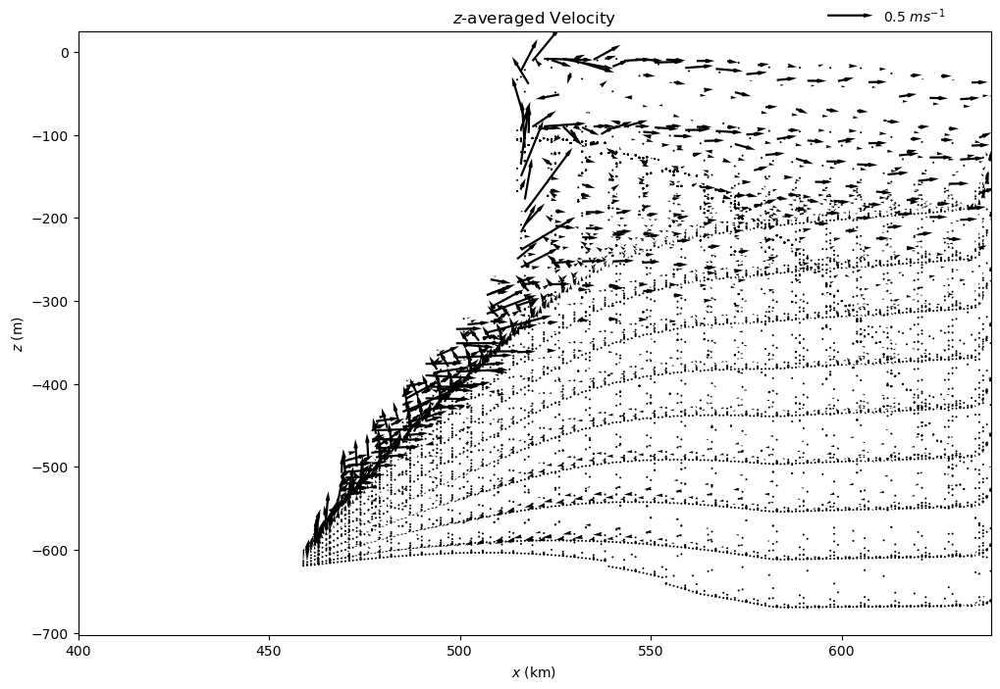

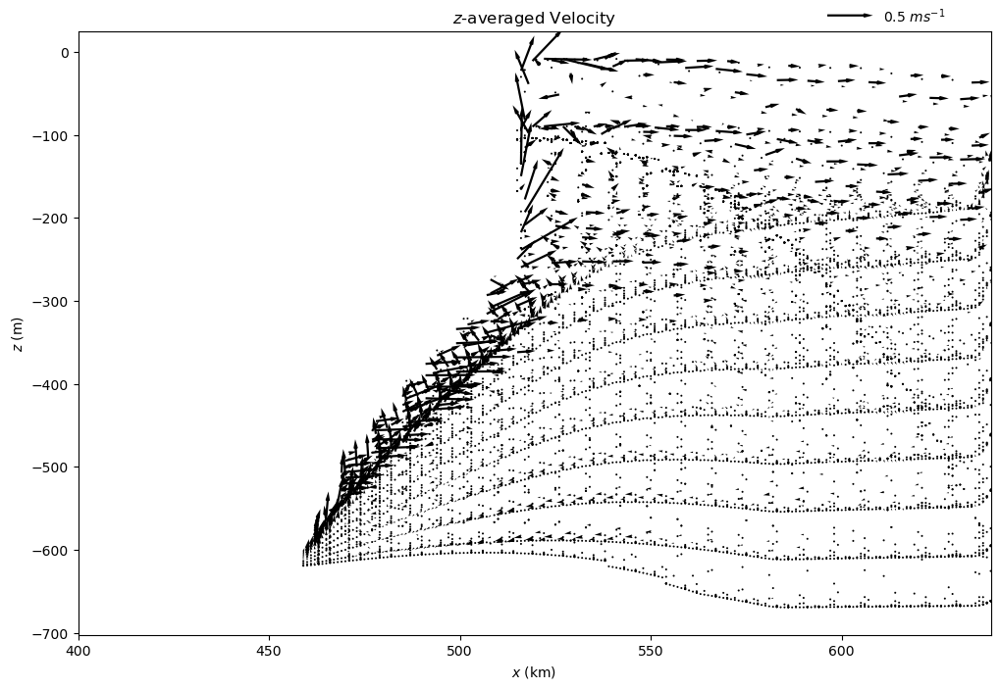

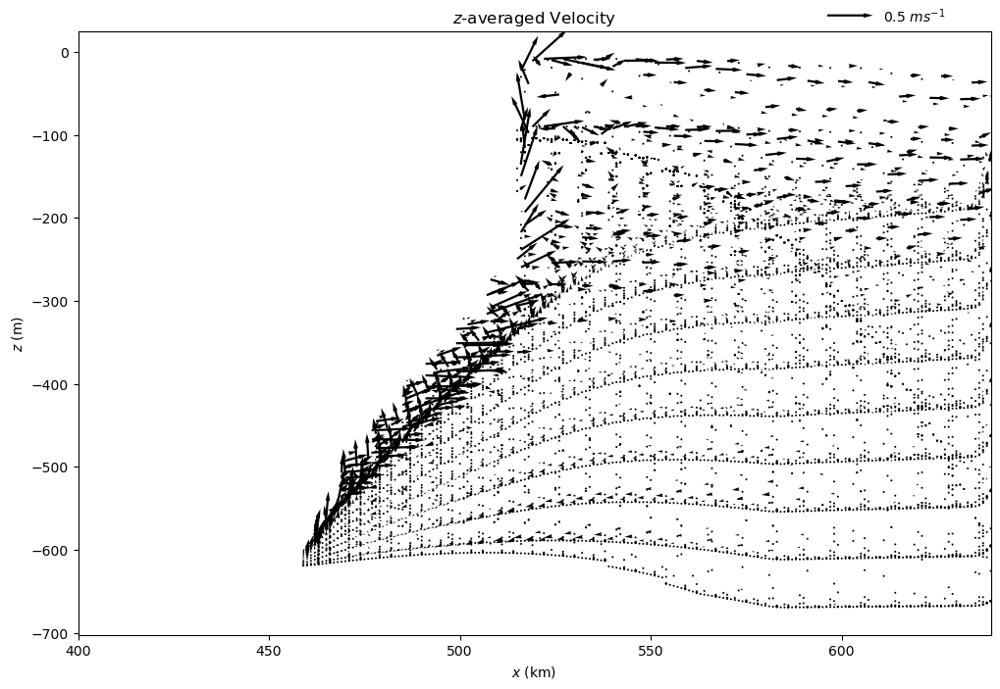

In [161]:
for midx in range(len(ds_output.Time)):
    fig,ax = plt.subplots(1, figsize=(12,8))
    # plt.quiver(reshaped_xCell/1000,ds_output.zMid.isel(Time=midx), ds_output.velocityX.isel(Time=midx), ds_output.velocityY.isel(Time=midx), color='k)
    x = reshaped_xCell/1000
    y = ds_output.zMid.isel(Time=midx)
    u = ds_output.velocityX.isel(Time=midx)
    v = ds_output.velocityY.isel(Time=midx)

    skip = (slice(None, None, 4), slice(None, None, 4))  ## reducing the density of the vectors
    Q = ax.quiver(x[skip], y[skip], u[skip], v[skip], color='black', headwidth=2, scale=10, headlength=4)
    q1 = ax.quiverkey(Q, 0.8, 0.9, 0.5,label='$0.5$ $m s^{-1}$', labelpos='E', coordinates='figure')
    ax.set_xlim(400, 639000.0/1000)
    ax.set_ylabel('$z$ (m)')
    ax.set_xlabel('$x$ (km)')
    ax.set_title('$z$-averaged Velocity')
    plt.show()

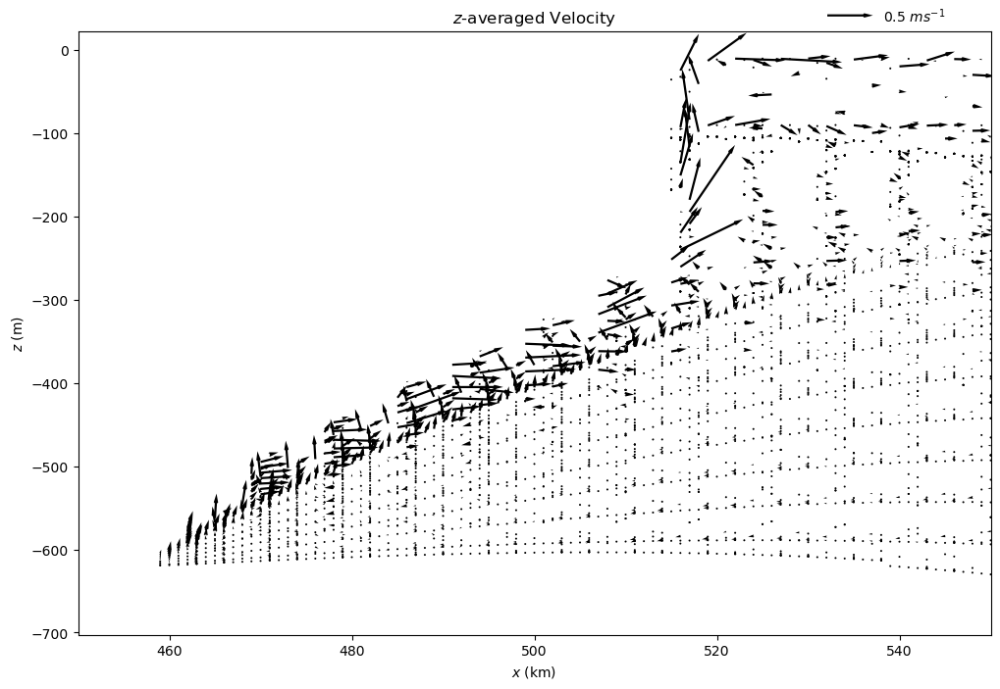

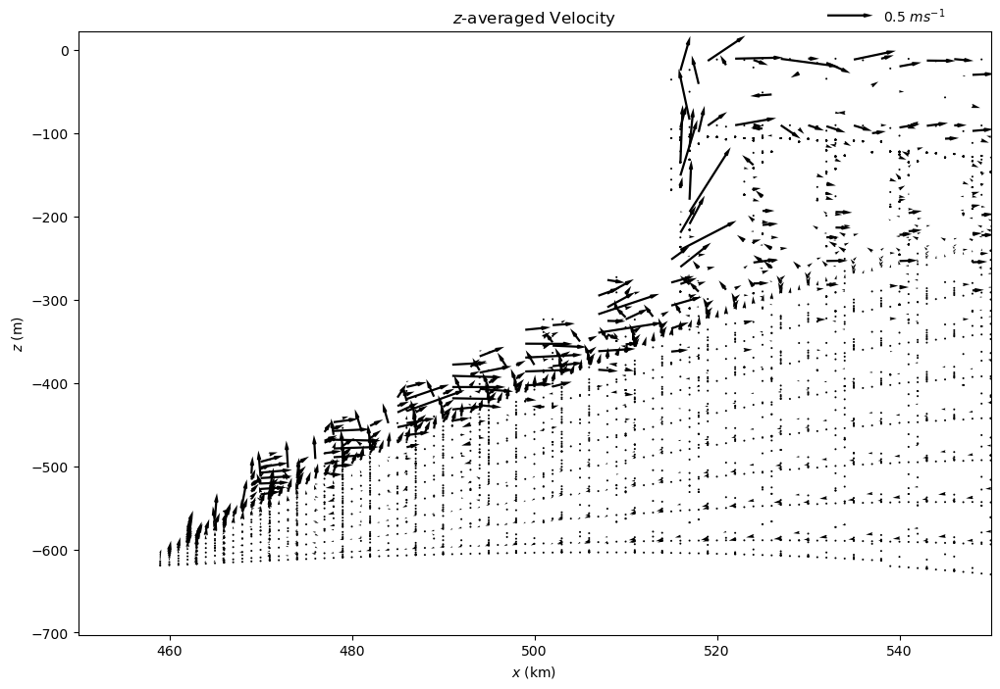

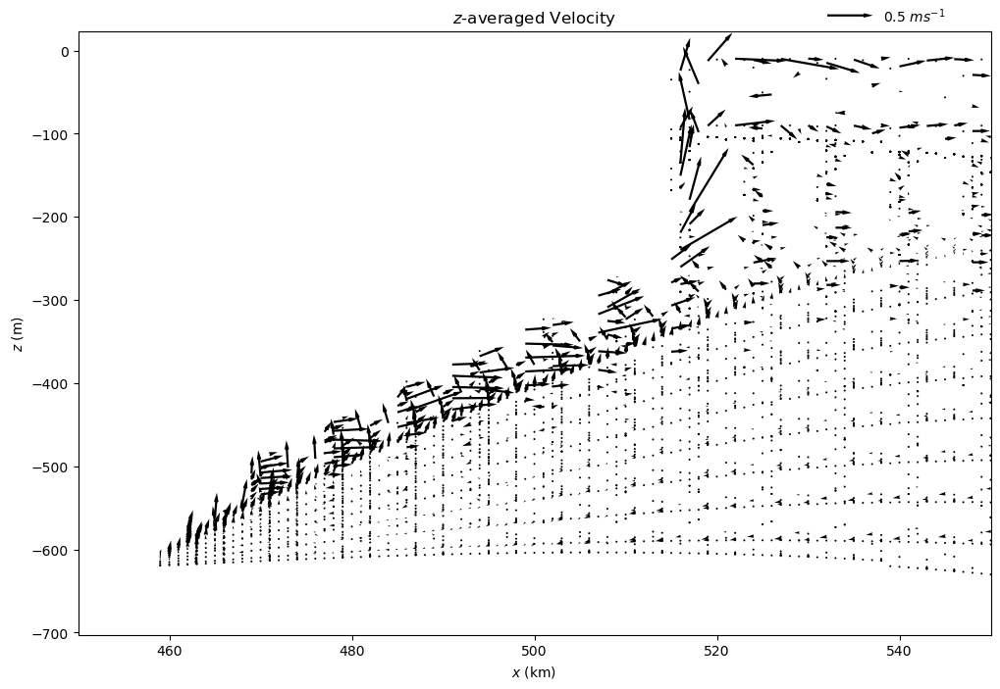

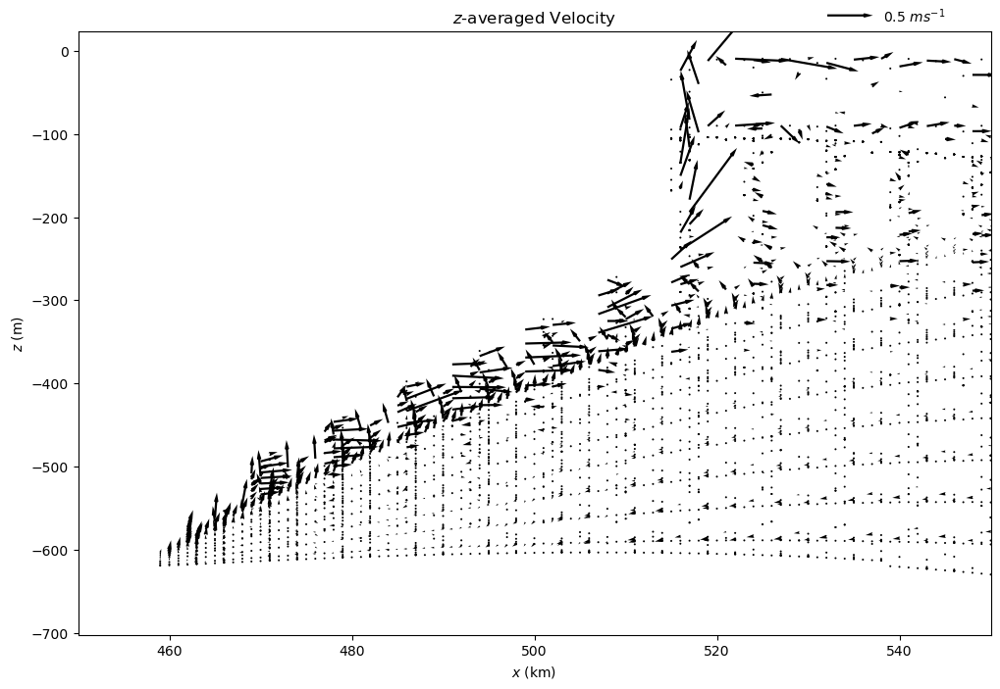

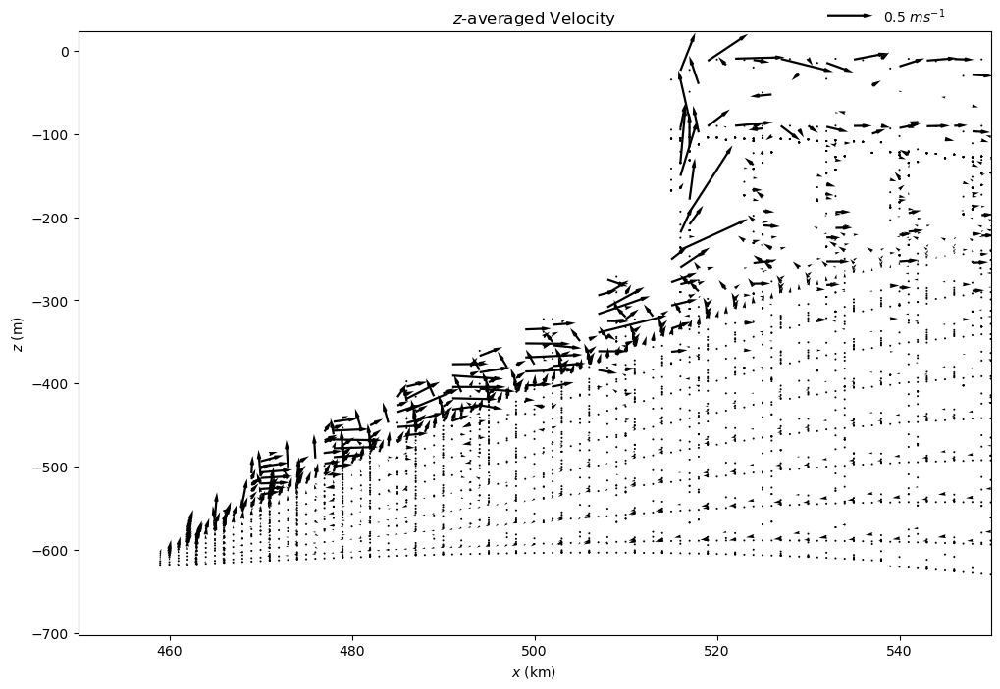

...

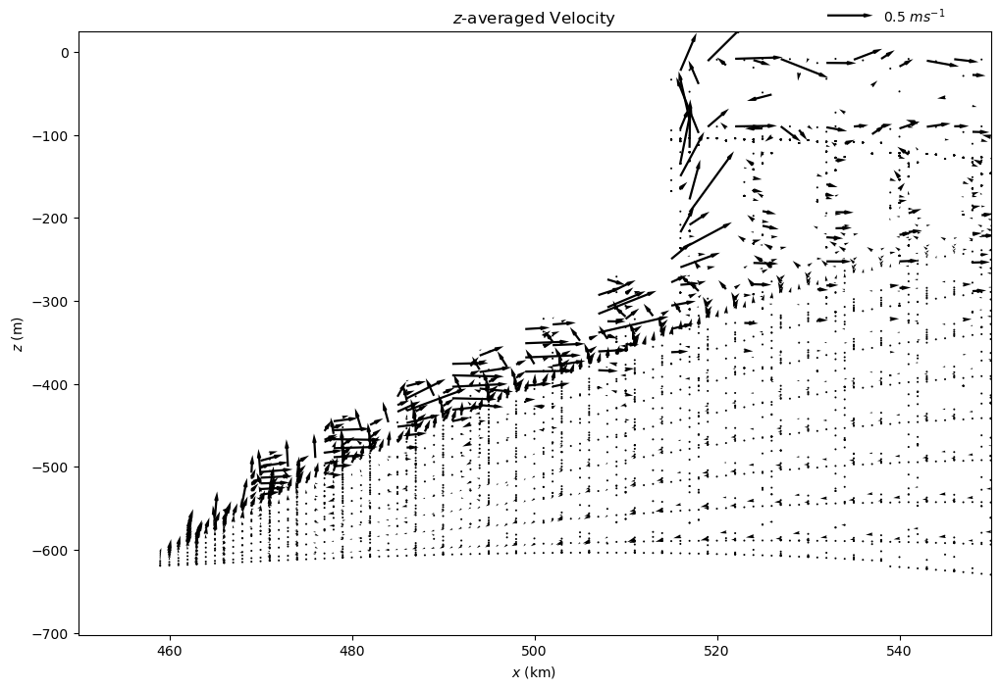

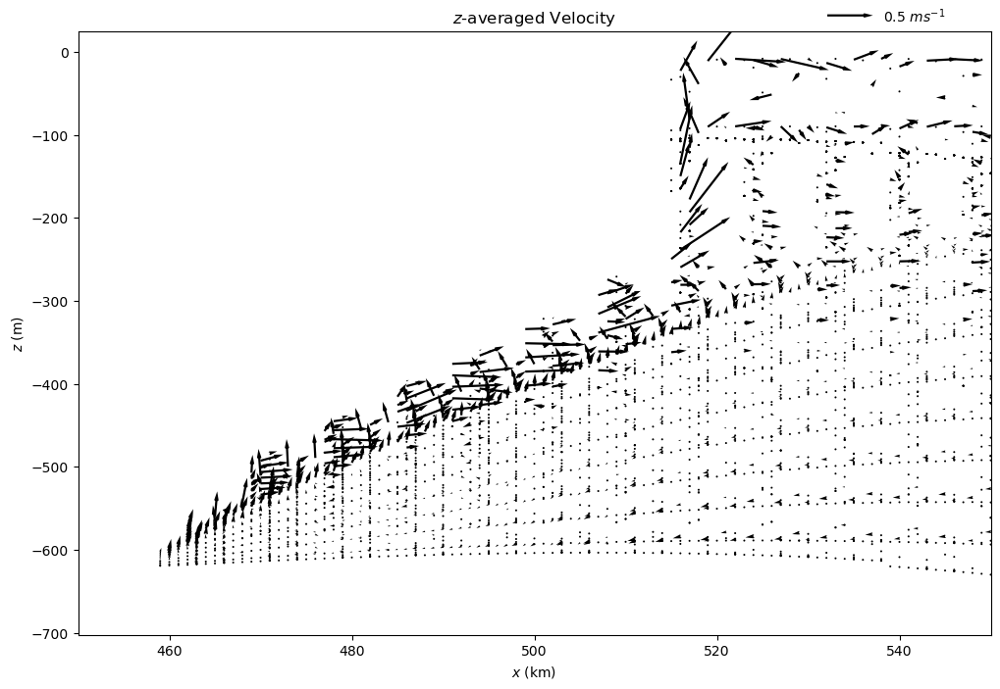

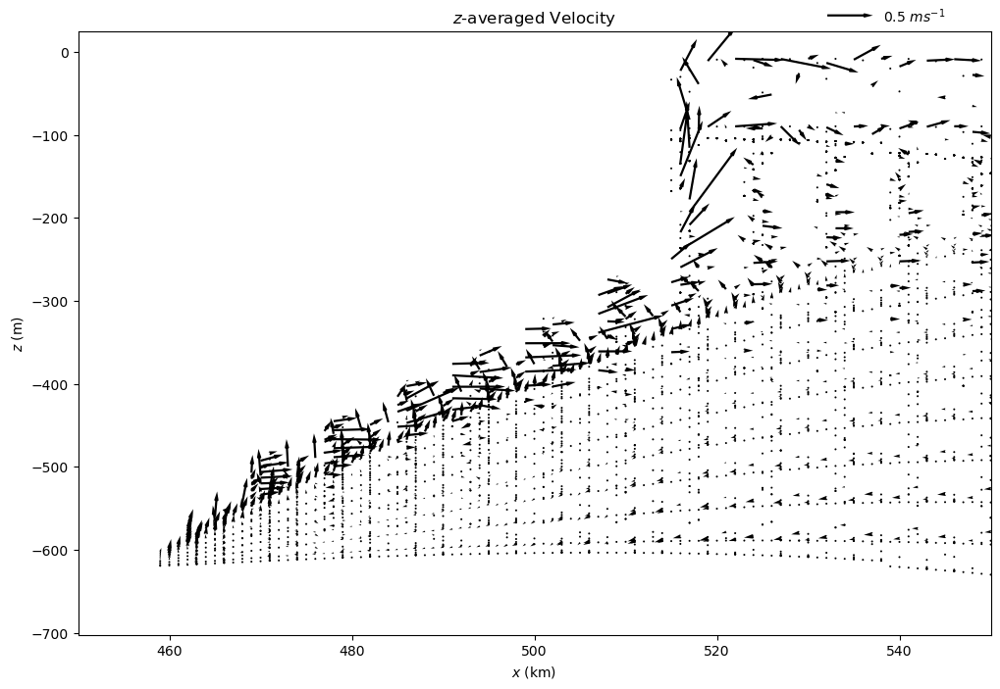

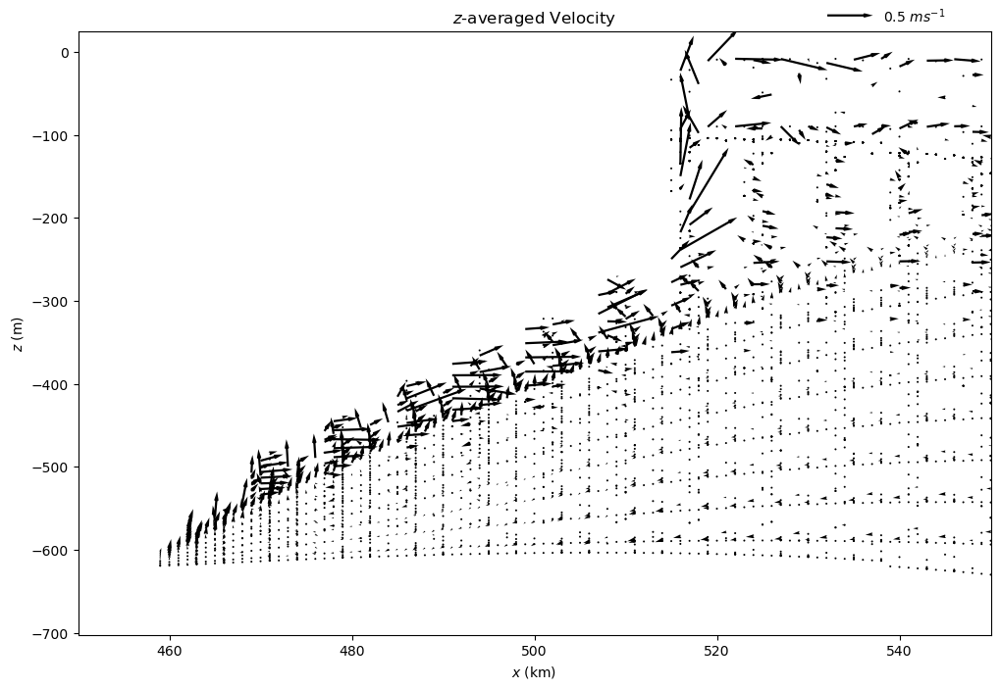

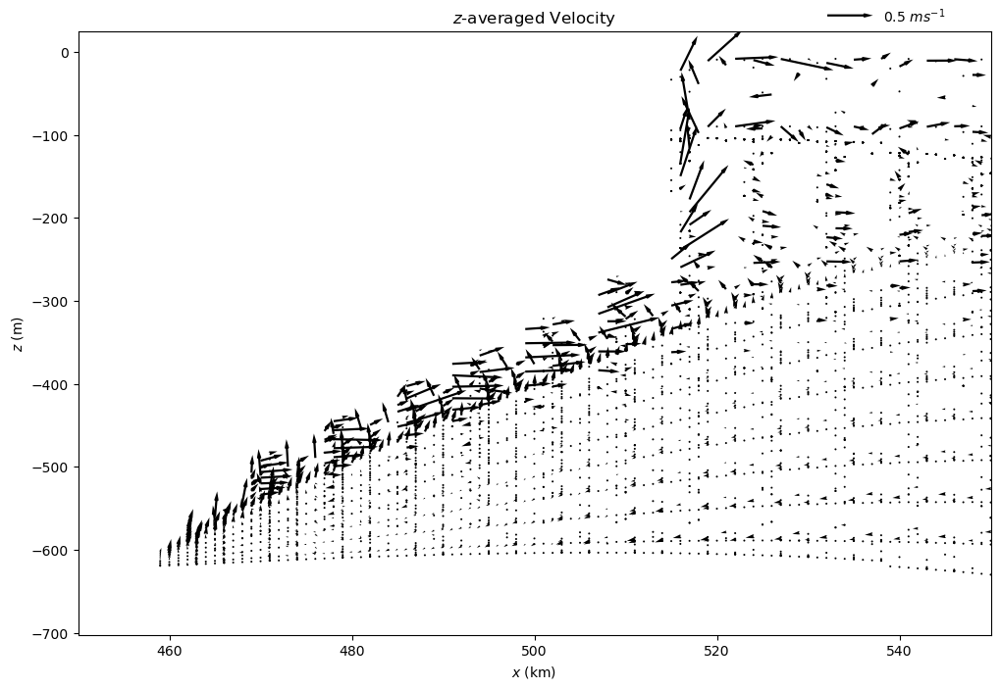

In [162]:
for midx in range(len(ds_output.Time)):
    fig,ax = plt.subplots(1, figsize=(12,8))
    # plt.quiver(reshaped_xCell/1000,ds_output.zMid.isel(Time=midx), ds_output.velocityX.isel(Time=midx), ds_output.velocityY.isel(Time=midx), color='k)
    x = reshaped_xCell/1000
    y = ds_output.zMid.isel(Time=midx)
    u = ds_output.velocityX.isel(Time=midx)
    v = ds_output.velocityY.isel(Time=midx)

    skip = (slice(None, None, 4), slice(None, None, 4))  ## reducing the density of the vectors
    Q = ax.quiver(x[skip], y[skip], u[skip], v[skip], color='black', headwidth=2, scale=10, headlength=4)
    q1 = ax.quiverkey(Q, 0.8, 0.9, 0.5,label='$0.5$ $m s^{-1}$', labelpos='E', coordinates='figure')
    ax.set_xlim(450, 550)
    ax.set_ylabel('$z$ (m)')
    ax.set_xlabel('$x$ (km)')
    ax.set_title('$z$-averaged Velocity')
    plt.show()

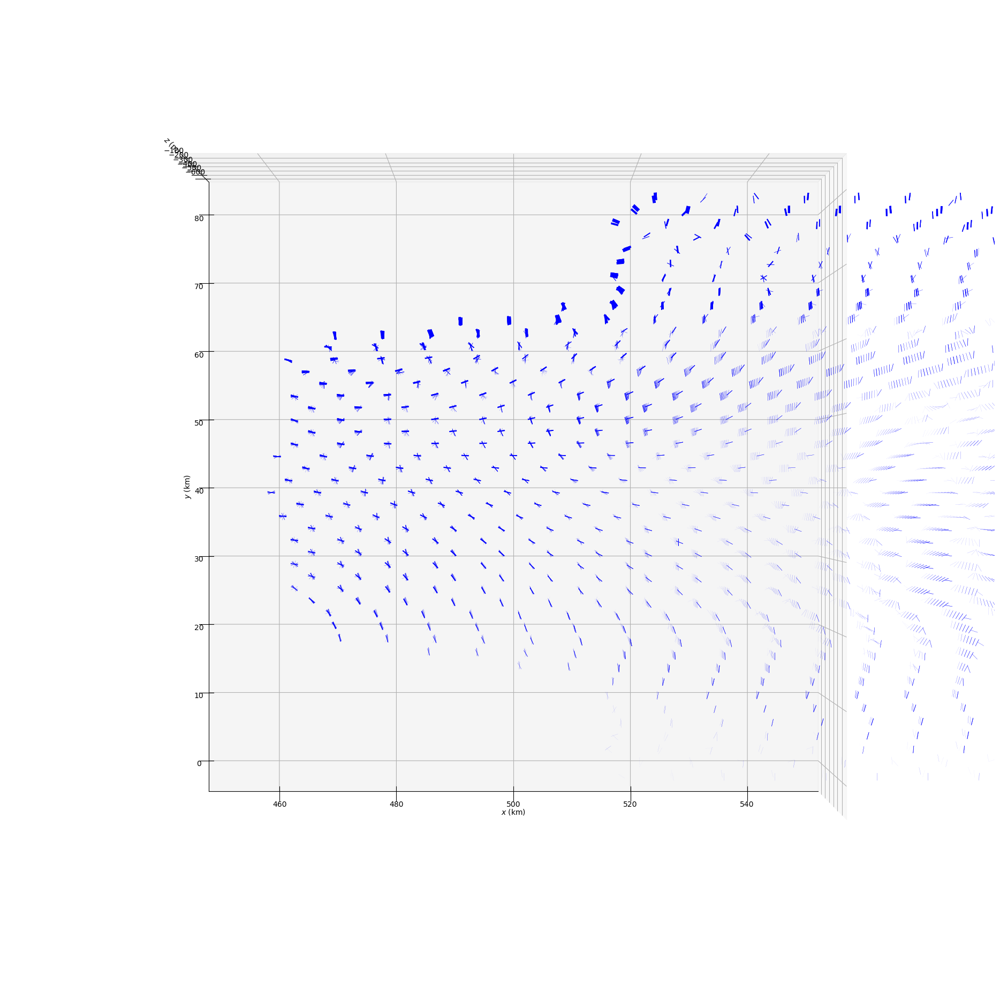

In [226]:
# %matplotlib widget 
%matplotlib inline
ax = plt.figure(figsize=(24,24)).add_subplot(111,projection='3d')

# Make the grid
reshaped_xCell = [ds_output.xCell.values for i in range(len(ds_output.nVertLevels))]
reshaped_xCell = np.transpose(reshaped_xCell)
reshaped_yCell = [ds_output.yCell.values for i in range(len(ds_output.nVertLevels))]
reshaped_yCell = np.transpose(reshaped_yCell)

x, y, z = reshaped_xCell/1000., reshaped_yCell/1000., ds_output.zMid.isel(Time=midx)


# Make the direction data for the arrows
u = ds_output.velocityX.isel(Time=midx)
v = ds_output.velocityY.isel(Time=midx)
w = ds_output.vertVelocityTop.isel(Time=midx,nVertLevelsP1=slice(1,37))

skip = (slice(None, None, 4), slice(None, None, 4))  ## reducing the density of the vectors
# ax.quiver(x, y, z, u, v, w,  linewidth=1, normalize=True)
ax.quiver(x[skip], y[skip], z[skip], u[skip], v[skip], w[skip], linewidth=10,color='blue') #

ax.set_ylabel('$y$ (km)')
ax.set_xlabel('$x$ (km)')
ax.set_zlabel('$z$ (m)')
ax.set_xlim(xmin=450,xmax=550)
# ax.set_ylim(500,500)
# ax.set_zlim(-700,0)
ax.azim = -90
ax.elev = 90

plt.show()

In [274]:
## find which indices are along the same y value
first = True
larger_same_y_idx = []
same_y_idx = []
y_val_start = ds_output.yCell[0]
for i in range(len(ds_output.xCell)):
    y_val = ds_output.yCell[i]
    if y_val == y_val_start:
        same_y_idx.append(i)
    else:
        larger_same_y_idx.append(same_y_idx)
        same_y_idx = []
        same_y_idx.append(i)
        y_val_start = y_val

In [253]:
len(larger_same_y_idx)

45

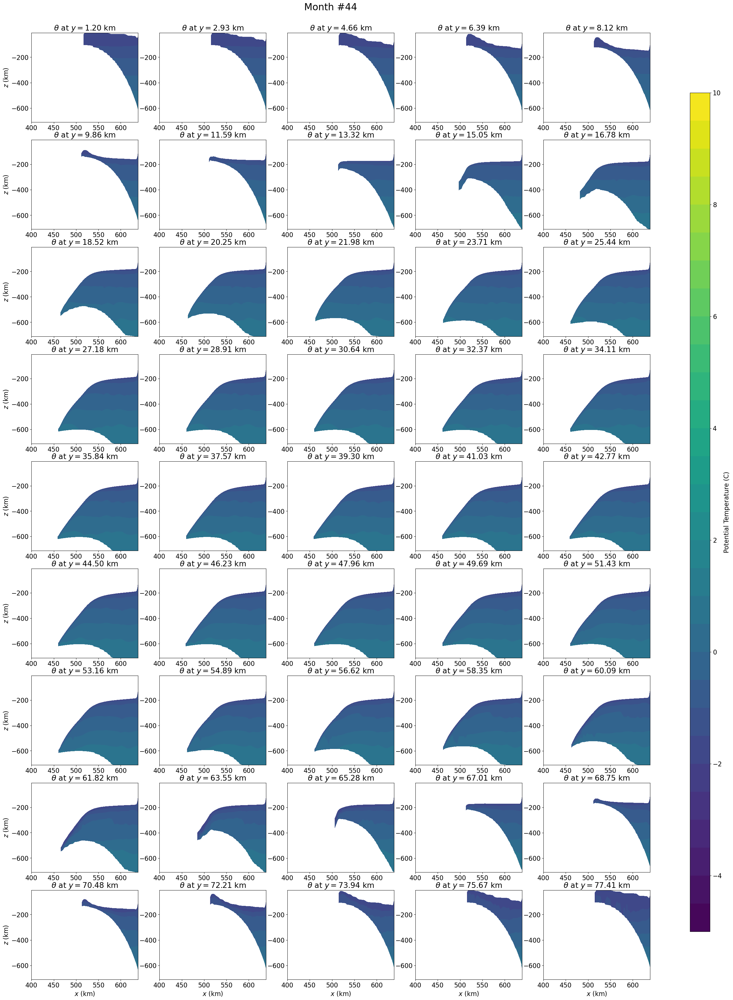

In [340]:
# %matplotlib widget 
%matplotlib inline

midx = 44
fig, ax = plt.subplots(9,5, figsize=(28,42))

y_idx = 0
for r in np.arange(0,9,1):
    for c in np.arange(0,5,1):
        # Make the grid
        reshaped_xCell = [ds_output.xCell.isel(nCells=larger_same_y_idx[y_idx]).values for i in range(len(ds_output.nVertLevels))]
        reshaped_xCell = np.transpose(reshaped_xCell)

        levs = np.arange(-5,10.5,0.5)
        im = ax[r,c].contourf(reshaped_xCell/1000.,ds_output.zMid.isel(Time=midx,nCells=larger_same_y_idx[y_idx]),ds_output.temperature.isel(Time=midx,nCells=larger_same_y_idx[y_idx]), 
                         levels=levs,cmap="viridis",alpha=1)

        ax[r,c].set_title(r'$\theta$ at $y = $'+"{0:.2f}".format(ds_output.yCell[larger_same_y_idx[y_idx][0]].values/1000)+' km')
        
        if r == 8:
            ax[r,c].set_xlabel('$x$ (km)')
        if c == 0:
            ax[r,c].set_ylabel('$z$ (km)')
        
        ax[r,c].set_xlim(xmin=400,xmax=639)
        
        y_idx+=1

fig.subplots_adjust(right=0.9,top=0.9)
cbar_ax = fig.add_axes([0.95, 0.15, 0.025, 0.7])
fig.colorbar(im, cax=cbar_ax,orientation='vertical', label = 'Potential Temperature (C)')
fig.suptitle('Month #'+str(midx), size=24, ha='center', x = 0.5, y = 0.925)
plt.show()

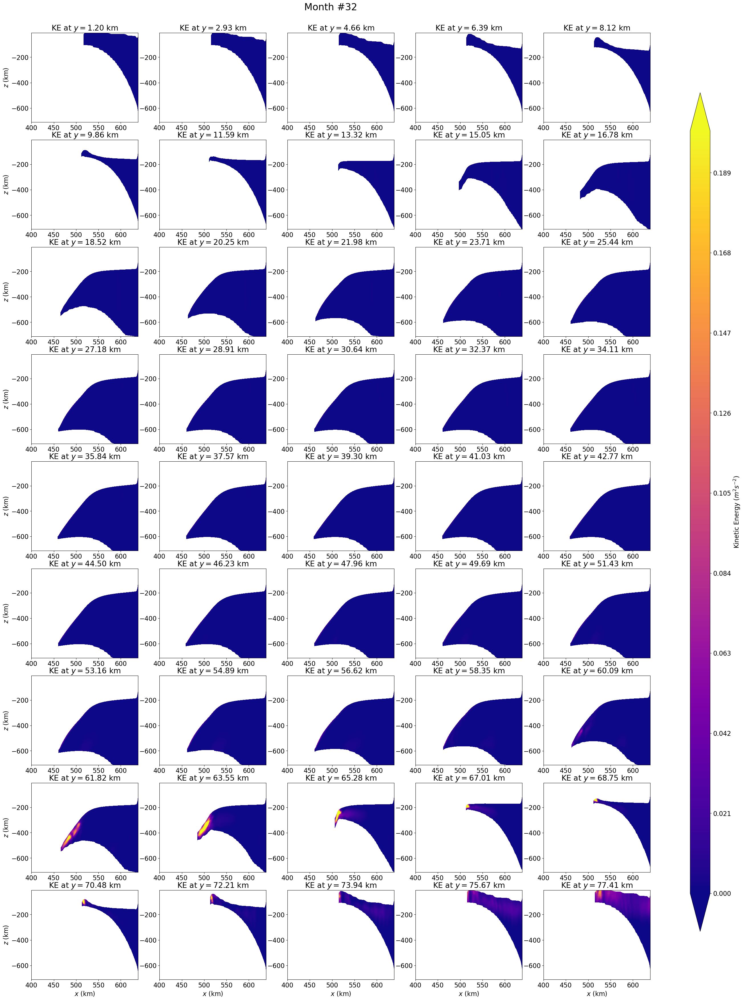

In [352]:
# %matplotlib widget 
%matplotlib inline

## kinetic energy of horizontal velocity on cells


midx = 32
fig, ax = plt.subplots(9,5, figsize=(28,42))

y_idx = 0
for r in np.arange(0,9,1):
    for c in np.arange(0,5,1):
        # Make the grid
        reshaped_xCell = [ds_output.xCell.isel(nCells=larger_same_y_idx[y_idx]).values for i in range(len(ds_output.nVertLevels))]
        reshaped_xCell = np.transpose(reshaped_xCell)

        levs = np.arange(0,0.201,0.001)
        im = ax[r,c].contourf(reshaped_xCell/1000.,ds_output.zMid.isel(Time=midx,nCells=larger_same_y_idx[y_idx]),ds_output.kineticEnergyCell.isel(Time=midx,nCells=larger_same_y_idx[y_idx]), 
                         levels=levs,cmap="plasma",alpha=1, extend='both')

        ax[r,c].set_title(r'KE at $y = $'+"{0:.2f}".format(ds_output.yCell[larger_same_y_idx[y_idx][0]].values/1000)+' km')
        
        if r == 8:
            ax[r,c].set_xlabel('$x$ (km)')
        if c == 0:
            ax[r,c].set_ylabel('$z$ (km)')
        
        ax[r,c].set_xlim(xmin=400,xmax=639)
        
        y_idx+=1

fig.subplots_adjust(right=0.9,top=0.9)
cbar_ax = fig.add_axes([0.95, 0.15, 0.025, 0.7])
fig.colorbar(im, cax=cbar_ax,orientation='vertical', label = 'Kinetic Energy (${m^2} s^{-2}$)')
fig.suptitle('Month #'+str(midx), size=24, ha='center', x = 0.5, y = 0.925)
plt.show()

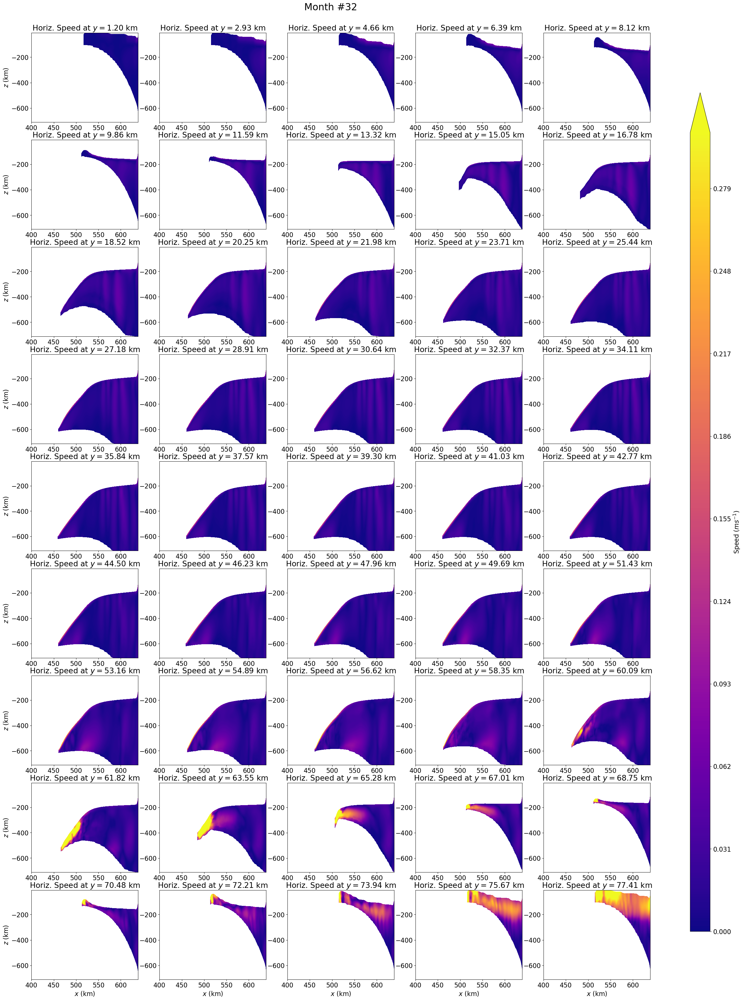

In [364]:
## speed
# %matplotlib widget 
%matplotlib inline

## kinetic energy of horizontal velocity on cells


midx = 32
fig, ax = plt.subplots(9,5, figsize=(28,42))

y_idx = 0
for r in np.arange(0,9,1):
    for c in np.arange(0,5,1):
        # Make the grid
        reshaped_xCell = [ds_output.xCell.isel(nCells=larger_same_y_idx[y_idx]).values for i in range(len(ds_output.nVertLevels))]
        reshaped_xCell = np.transpose(reshaped_xCell)

        speed = (ds_output.velocityX.isel(Time=midx,nCells=larger_same_y_idx[y_idx])**2 + ds_output.velocityY.isel(Time=midx,nCells=larger_same_y_idx[y_idx])**2)**0.5
        levs = np.arange(0,0.301,0.001)
        im = ax[r,c].contourf(reshaped_xCell/1000.,ds_output.zMid.isel(Time=midx,nCells=larger_same_y_idx[y_idx]),speed, 
                         levels=levs,cmap="plasma",alpha=1, extend='max')

        ax[r,c].set_title(r'Horiz. Speed at $y = $'+"{0:.2f}".format(ds_output.yCell[larger_same_y_idx[y_idx][0]].values/1000)+' km')
        
        if r == 8:
            ax[r,c].set_xlabel('$x$ (km)')
        if c == 0:
            ax[r,c].set_ylabel('$z$ (km)')
        
        ax[r,c].set_xlim(xmin=400,xmax=639)
        
        y_idx+=1

fig.subplots_adjust(right=0.9,top=0.9)
cbar_ax = fig.add_axes([0.95, 0.15, 0.025, 0.7])
fig.colorbar(im, cax=cbar_ax,orientation='vertical', label = 'Speed ($m s^{-1}$)')
fig.suptitle('Month #'+str(midx), size=24, ha='center', x = 0.5, y = 0.925)
plt.show()

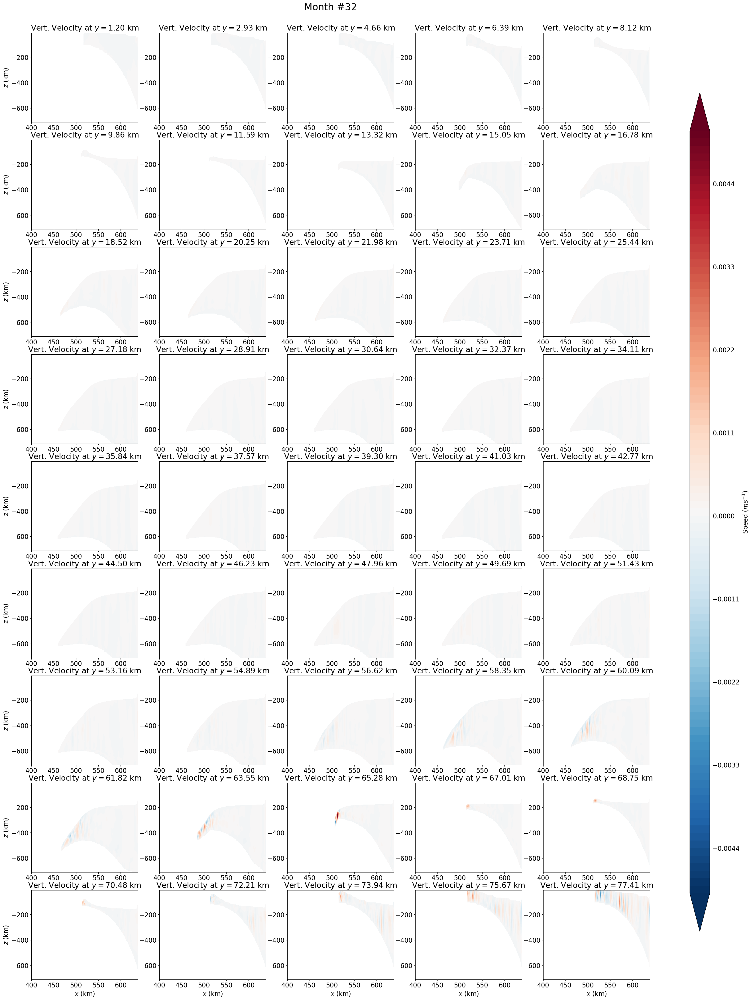

In [371]:
## speed
# %matplotlib widget 
%matplotlib inline

## kinetic energy of horizontal velocity on cells


midx = 32
fig, ax = plt.subplots(9,5, figsize=(28,42))

y_idx = 0
for r in np.arange(0,9,1):
    for c in np.arange(0,5,1):
        # Make the grid
        reshaped_xCell = [ds_output.xCell.isel(nCells=larger_same_y_idx[y_idx]).values for i in range(len(ds_output.nVertLevels))]
        reshaped_xCell = np.transpose(reshaped_xCell)

        # speed = (ds_output.velocityX.isel(Time=midx,nCells=larger_same_y_idx[y_idx])**2 + ds_output.velocityY.isel(Time=midx,nCells=larger_same_y_idx[y_idx])**2)**0.5
        levs = np.arange(-0.005,0.0051,0.0001)
        im = ax[r,c].contourf(reshaped_xCell/1000.,ds_output.zMid.isel(Time=midx,nCells=larger_same_y_idx[y_idx]),ds_output.vertVelocityTop.isel(Time=midx,nCells=larger_same_y_idx[y_idx],nVertLevelsP1=slice(1,37)), 
                         levels=levs,cmap="RdBu_r",alpha=1, extend='both')

        ax[r,c].set_title(r'Vert. Velocity at $y = $'+"{0:.2f}".format(ds_output.yCell[larger_same_y_idx[y_idx][0]].values/1000)+' km')
        
        if r == 8:
            ax[r,c].set_xlabel('$x$ (km)')
        if c == 0:
            ax[r,c].set_ylabel('$z$ (km)')
        
        ax[r,c].set_xlim(xmin=400,xmax=639)
        
        y_idx+=1

fig.subplots_adjust(right=0.9,top=0.9)
cbar_ax = fig.add_axes([0.95, 0.15, 0.025, 0.7])
fig.colorbar(im, cax=cbar_ax,orientation='vertical', label = 'Speed ($m s^{-1}$)')
fig.suptitle('Month #'+str(midx), size=24, ha='center', x = 0.5, y = 0.925)
plt.show()

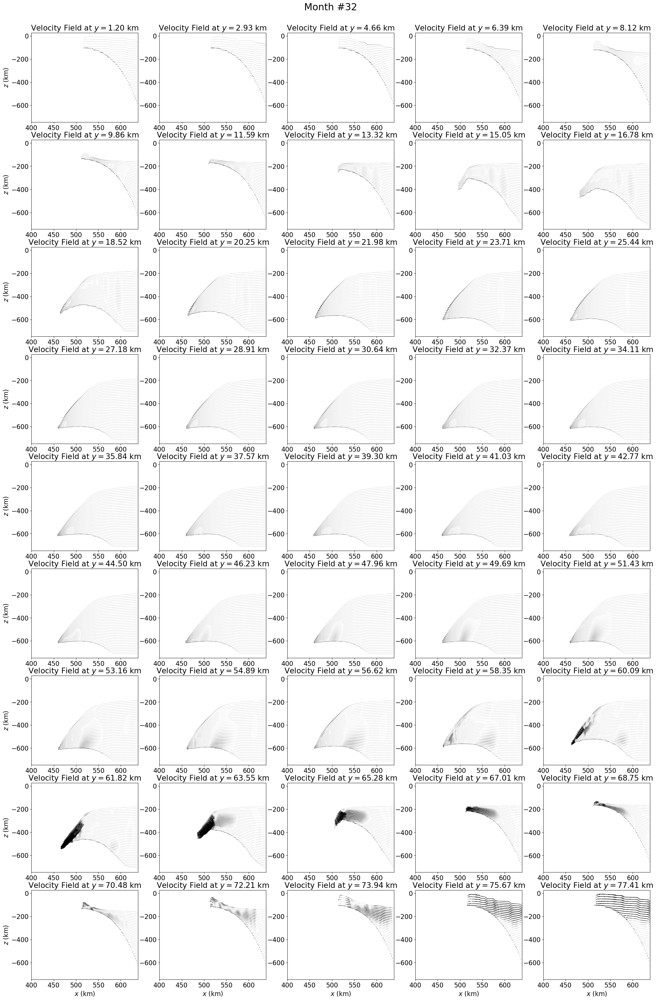

In [363]:
# %matplotlib widget 
%matplotlib inline

## kinetic energy of horizontal velocity on cells


midx = 32
fig, ax = plt.subplots(9,5, figsize=(28,42))

y_idx = 0
for r in np.arange(0,9,1):
    for c in np.arange(0,5,1):
        # Make the grid
        reshaped_xCell = [ds_output.xCell.isel(nCells=larger_same_y_idx[y_idx]).values for i in range(len(ds_output.nVertLevels))]
        reshaped_xCell = np.transpose(reshaped_xCell)

        levs = np.arange(0,0.201,0.001)
        Q = ax[r,c].quiver(reshaped_xCell/1000.,ds_output.zMid.isel(Time=midx,nCells=larger_same_y_idx[y_idx]), 
                           ds_output.velocityX.isel(Time=midx,nCells=larger_same_y_idx[y_idx]), ds_output.vertVelocityTop.isel(Time=midx,nCells=larger_same_y_idx[y_idx], nVertLevelsP1=slice(1,37)), 
                           color='black', headwidth=2, scale=10, headlength=4)
        # q1 = ax[r,c].quiverkey(Q, 0.8, 0.9, 0.5,label='$0.5$ $m s^{-1}$', labelpos='E', coordinates='figure')

        ax[r,c].set_title(r'Velocity Field at $y = $'+"{0:.2f}".format(ds_output.yCell[larger_same_y_idx[y_idx][0]].values/1000)+' km')
        
        if r == 8:
            ax[r,c].set_xlabel('$x$ (km)')
        if c == 0:
            ax[r,c].set_ylabel('$z$ (km)')
        
        ax[r,c].set_xlim(xmin=400,xmax=639)
        
        y_idx+=1

fig.subplots_adjust(top=0.9)
fig.suptitle('Month #'+str(midx), size=24, ha='center', x = 0.5, y = 0.925)
plt.show()

In [386]:
## find which indices are along the same x value
seen = set()
uniq = []
for x in ds_output.xCell.values:
    if x not in seen:
        uniq.append(x)
        seen.add(x)
        
first = True
larger_same_x_idx = []
same_x_idx = []
for search_val in uniq:
    x_val_start = search_val
    for i in range(len(ds_output.xCell)):
        x_val = ds_output.xCell[i]
        if x_val == x_val_start:
            same_x_idx.append(i)
    larger_same_x_idx.append(same_x_idx)
    same_x_idx = []

In [ ]:
# %matplotlib widget 
%matplotlib inline

midx = 32
fig, ax = plt.subplots(12,5, figsize=(28,52))

x_idx = 0
for r in np.arange(0,12,1):
    for c in np.arange(0,5,1):
        # Make the grid
        reshaped_yCell = [ds_output.yCell.isel(nCells=larger_same_x_idx[x_idx]).values for i in range(len(ds_output.nVertLevels))]
        reshaped_yCell = np.transpose(reshaped_yCell)

        levs = np.arange(0,0.201,0.001)
        Q = ax[r,c].quiver(reshaped_yCell/1000.,ds_output.zMid.isel(Time=midx,nCells=larger_same_x_idx[x_idx]), 
                           ds_output.velocityY.isel(Time=midx,nCells=larger_same_x_idx[x_idx]), ds_output.vertVelocityTop.isel(Time=midx,nCells=larger_same_x_idx[x_idx], nVertLevelsP1=slice(1,37)), 
                           color='black', headwidth=2, scale=10, headlength=4)
        # q1 = ax[r,c].quiverkey(Q, 0.8, 0.9, 0.5,label='$0.5$ $m s^{-1}$', labelpos='E', coordinates='figure')

        ax[r,c].set_title(r'Velocity Field at $x = $'+"{0:.2f}".format(ds_output.xCell[larger_same_x_idx[x_idx][0]].values/1000)+' km')
        
        if r == 11:
            ax[r,c].set_xlabel('$y$ (km)')
        if c == 0:
            ax[r,c].set_ylabel('$z$ (km)')
        
        # ax[r,c].set_xlim(xmin=400,xmax=639)
        
        x_idx+=1

fig.subplots_adjust(top=0.9)
fig.suptitle('Month #'+str(midx), size=24, ha='center', x = 0.5, y = 0.925)
plt.show()

In [392]:
len(larger_same_x_idx)

341

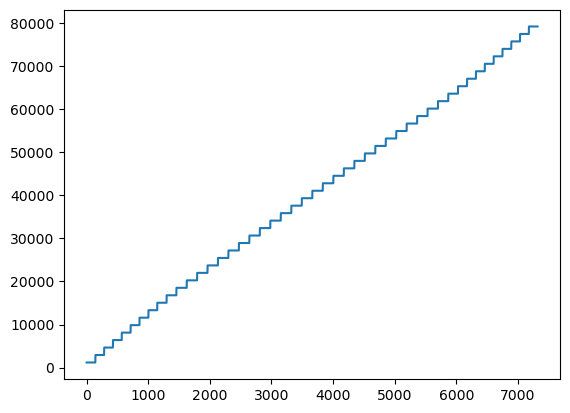

In [271]:
plt.plot(np.arange(0,len(ds_output.yCell)),ds_output.yCell, ')

In [294]:
print("Duplicate elements in given array: ");    
for k in range(len(ds_output.nVertLevels)):
    arr = ds_output.zMid.isel(Time=midx,nCells=larger_same_y_idx[30], nVertLevels=k).values
    #Searches for duplicate element    
    for i in range(0, len(arr)):    
        for j in range(i+1, len(arr)):    
            if(arr[i] == arr[j]):    
                print(arr[j]);   

Duplicate elements in given array: 


In [351]:
ds_output.kineticEnergyCell

<xarray.DataArray 'kineticEnergyCell' (Time: 67, nCells: 7319, nVertLevels: 36)> Size: 141MB
array([[[3.121677e-06, 7.177082e-07, ..., 0.000000e+00, 0.000000e+00],
        [1.044897e-05, 6.639213e-06, ..., 0.000000e+00, 0.000000e+00],
        ...,
        [1.318901e-02, 1.393473e-02, ..., 2.018822e-03, 1.793050e-03],
        [5.383633e-03, 5.718134e-03, ..., 5.482054e-04, 5.178303e-04]],

       [[8.263881e-06, 3.445543e-06, ..., 0.000000e+00, 0.000000e+00],
        [9.811827e-06, 3.396879e-06, ..., 0.000000e+00, 0.000000e+00],
        ...,
        [4.408766e-02, 3.951956e-02, ..., 2.889456e-04, 2.522948e-04],
        [2.291121e-02, 2.013572e-02, ..., 1.322214e-05, 1.434670e-05]],

       ...,

       [[4.656238e-07, 1.879996e-06, ..., 0.000000e+00, 0.000000e+00],
        [2.236738e-07, 1.515153e-06, ..., 0.000000e+00, 0.000000e+00],
        ...,
        [3.862667e-02, 2.860897e-02, ..., 1.763796e-04, 1.575023e-04],
        [1.936433e-02, 1.400865e-02, ..., 4.558183e-05, 4.850285e-05]],

       [[4.056611e-07, 1.248654e-06, ..., 0.000000e+00, 0.000000e+00],
        [3.717586e-07, 8.332340e-07, ..., 0.000000e+00, 0.000000e+00],
        ...,
        [6.546947e-02, 5.534564e-02, ..., 2.074395e-04, 1.833601e-04],
        [3.827071e-02, 3.114302e-02, ..., 7.682900e-05, 7.755550e-05]]])
Dimensions without coordinates: Time, nCells, nVertLevels
Attributes:
    units:               m^2 s^-2
    long_name:           kinetic energy of horizontal velocity on cells
    missing_value_mask:  cellMask

In [4]:
xr.open_dataset('/pscratch/sd/m/mlarson/isomip_plus_2km_z-star_Ocean0/ocean/isomip_plus/planar/2km/z-star/Ocean0/streamfunction/cache/osf_vert_slice_191.nc')

<xarray.Dataset> Size: 53kB
Dimensions:  (Time: 46, nz: 144)
Coordinates:
  * Time     (Time) object 368B 0001-01-16 12:00:00 ... 0004-10-16 12:00:00
Dimensions without coordinates: nz
Data variables:
    osf      (Time, nz) float64 53kB ...
Attributes:
    history:  Thu May 23 13:42:46 2024: /global/u2/m/mlarson/miniforge3/envs/...

In [3]:
xr.open_dataset('/pscratch/sd/m/mlarson/isomip_plus_2km_z-star_Ocean0/ocean/isomip_plus/planar/2km/z-star/Ocean0/viz/haney.nc')

<xarray.Dataset> Size: 573MB
Dimensions:             (Time: 67, nEdges: 22379, nVertLevels: 36, nCells: 7319)
Coordinates:
  * Time                (Time) object 536B 0001-01-16 12:00:00 ... 0006-07-16...
Dimensions without coordinates: nEdges, nVertLevels, nCells
Data variables:
    xtime_startMonthly  (Time) |S64 4kB ...
    xtime_endMonthly    (Time) |S64 4kB ...
    haneyEdge           (Time, nEdges, nVertLevels) float64 432MB ...
    haneyCell           (Time, nCells, nVertLevels) float64 141MB ...
Attributes:
    history:  Mon May 27 14:28:21 2024: /global/u2/m/mlarson/miniforge3/envs/...